# Refine tangram annotations using clustering for bone_s0

In [1]:
slide_id = "bone_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_bone_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 36158, 34751), (3, 18079, 17376)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (33801, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (33801, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_2694/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 33801 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,39.398744,Naive CD8 T cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,13.523513,S100A+ preNeutrophil (cycling)
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,14.292773,cDC1
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.247191,Effector/Memory CD4 T cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,9.889662,Late hemoglobin+ erythroblast
...,...,...,...,...,...
aaaaieae-1,nucleus_boundaries,morpho,aaaaieae-1,27.319998,Megakaryocyte
aaaaieaf-1,nucleus_boundaries,morpho,aaaaieaf-1,11.741766,ILC
aaaaieag-1,nucleus_boundaries,morpho,aaaaieag-1,6.321927,Treg
aaaaieah-1,nucleus_boundaries,morpho,aaaaieah-1,30.885101,cDC1


In [6]:
adata_ini.var

""
ABCC11
ACAN
ACE2
ACKR1
ACTA2
...
VPREB3
VSIG4
VWA5A
VWF


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,39.398744,Naive CD8 T cell,8
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,13.523513,S100A+ preNeutrophil (cycling),10
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,14.292773,cDC1,3
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.247191,Effector/Memory CD4 T cell,11
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,9.889662,Late hemoglobin+ erythroblast,2
...,...,...,...,...,...,...
aaaaieae-1,nucleus_boundaries,morpho,aaaaieae-1,27.319998,Megakaryocyte,6
aaaaieaf-1,nucleus_boundaries,morpho,aaaaieaf-1,11.741766,ILC,0
aaaaieag-1,nucleus_boundaries,morpho,aaaaieag-1,6.321927,Treg,1
aaaaieah-1,nucleus_boundaries,morpho,aaaaieah-1,30.885101,cDC1,1


<Axes: >

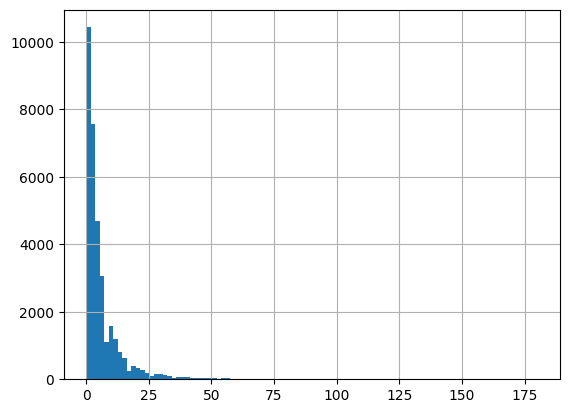

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

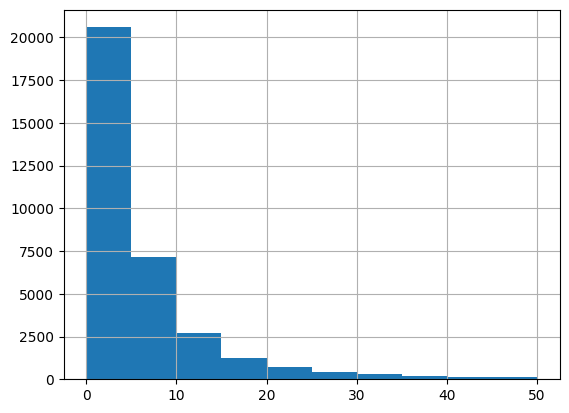

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 31685
Percentage of cells with less than 20 transcripts: 93.74%
-----
Number of cells with less than 15 transcripts: 30438
Percentage of cells with less than 15 transcripts: 90.05%
-----
Number of cells with less than 10 transcripts: 27727
Percentage of cells with less than 10 transcripts: 82.03%
-----
Number total of cells: 33801


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

5365


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


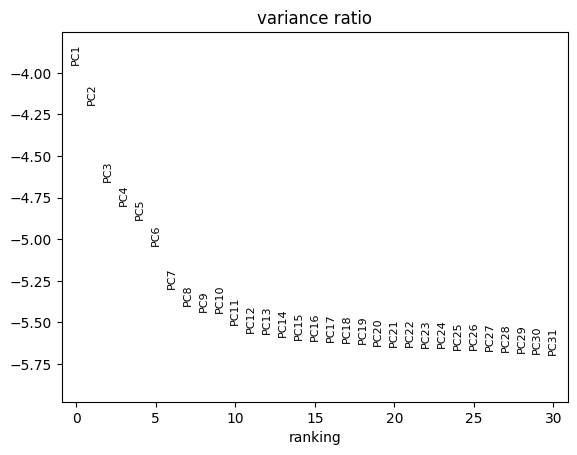

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 5365 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_2694/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


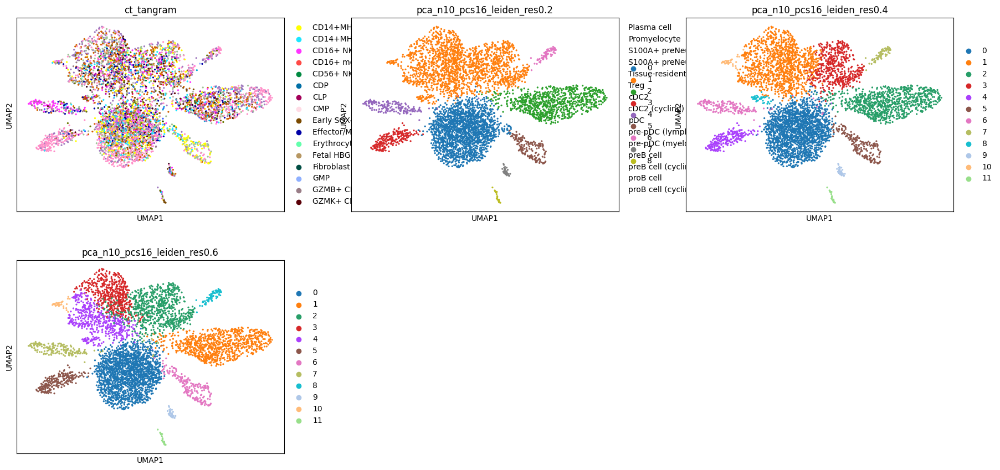

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

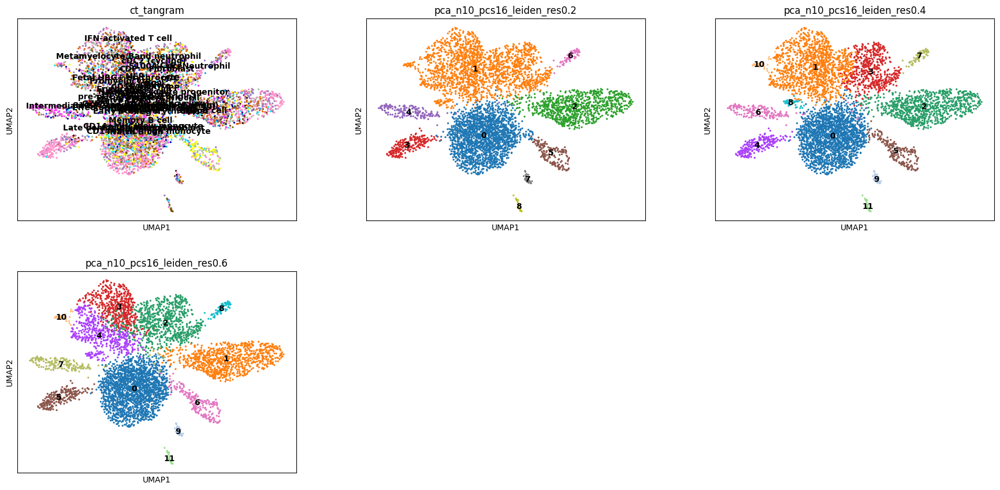

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

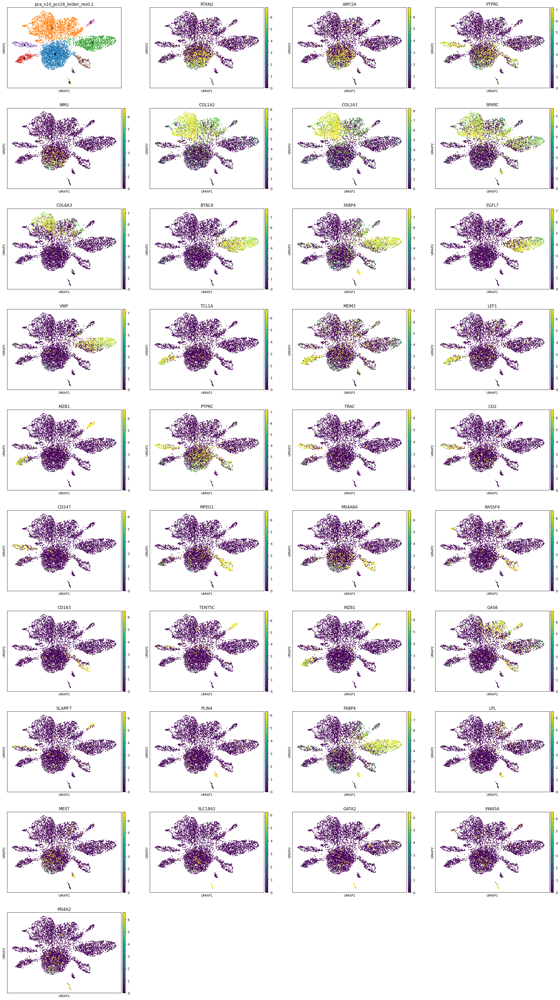

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

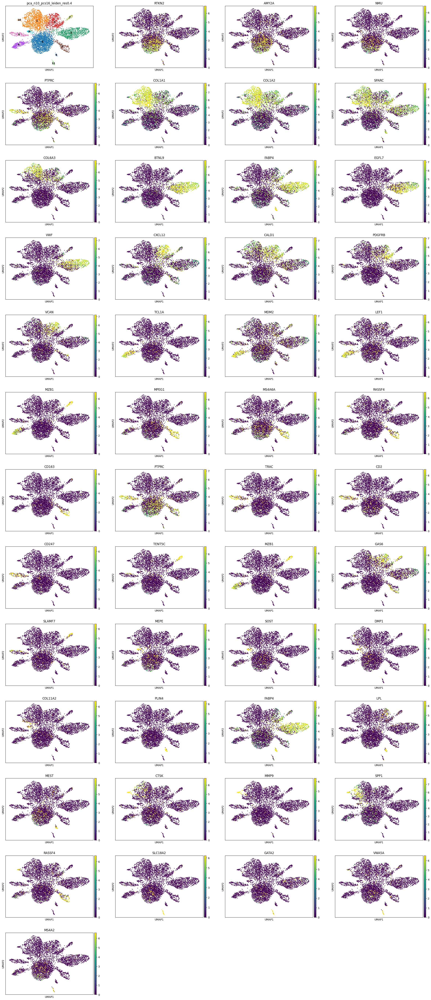

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['4', '3', '5', '0', '2', ..., '6', '9', '7', '8', '11']
Length: 12
Categories (12, object): ['0', '1', '2', '3', ..., '8', '9', '10', '11']

In [25]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'

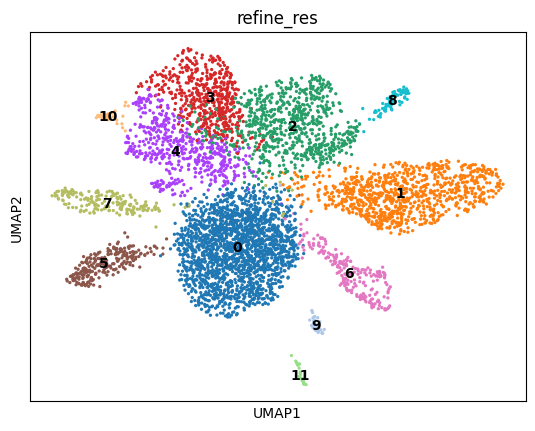

In [26]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [27]:
clustering_label = 'refine_res'

In [28]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_2694/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


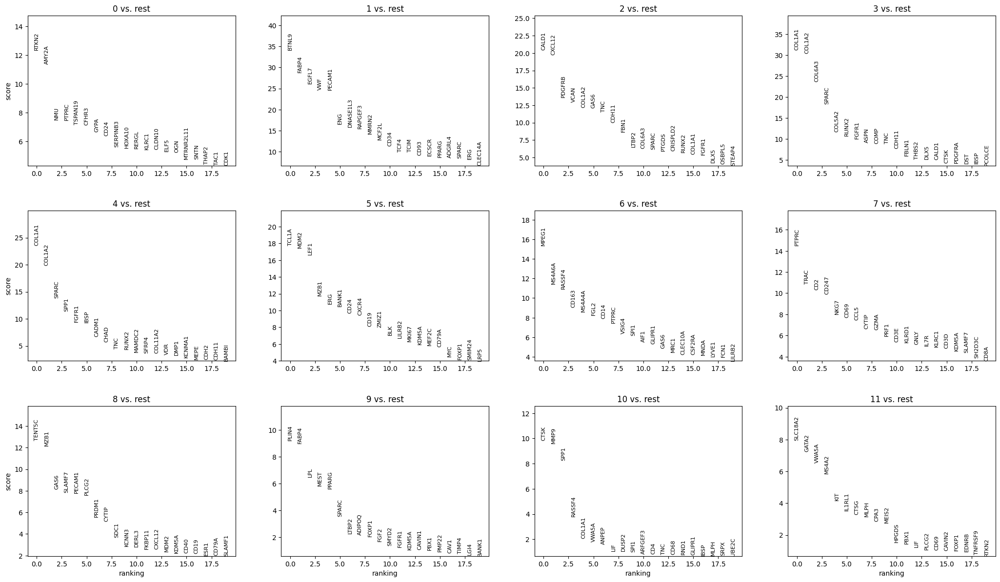

In [29]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [30]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [120]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [121]:
cluster_id = '0'

In [33]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Naive B cell,27
1,0,preB cell,13
2,0,CD14+MHCIIhigh monocyte,11
3,0,S100A+ preNeutrophil (cycling),9
4,0,CD14+MHCIIlow monocyte,7
5,0,Naive CD8 T cell,7
6,0,CD16+ NK,5


In [34]:
top_ranked_genes[cluster_id]

0      RTKN2
1      AMY2A
2        NMU
3      PTPRC
4    TSPAN19
Name: 0, dtype: object

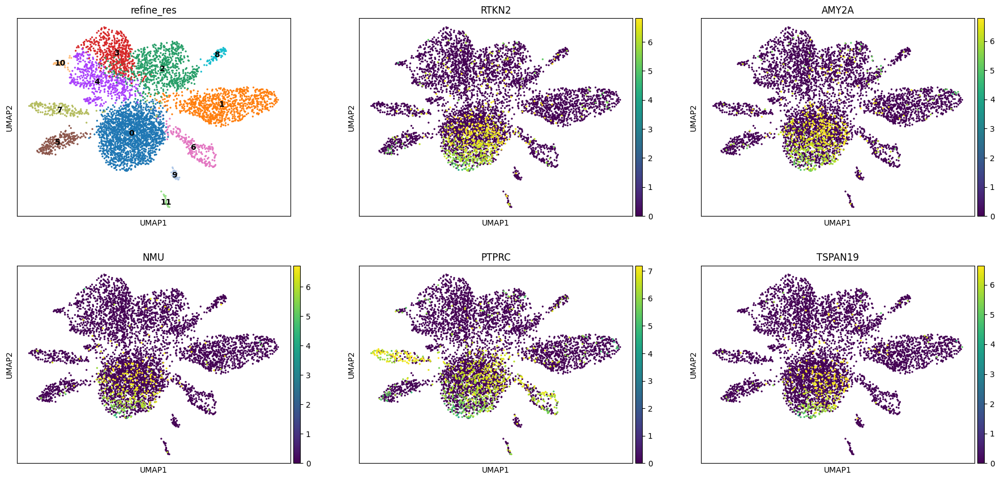

In [35]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 1924
Percentage of cells in cluster 0: 35.9


In [122]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.2. Cluster 1

In [123]:
cluster_id = '1'

In [38]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Naive B cell,21
8,1,preB cell,18
9,1,Naive CD8 T cell,13
10,1,S100A+ preNeutrophil (cycling),9
11,1,Early SOX4+ erythroblast,6
12,1,CD16+ NK,4
13,1,CD14+MHCIIhigh monocyte,4


In [39]:
top_ranked_genes[cluster_id]

0     BTNL9
1     FABP4
2     EGFL7
3       VWF
4    PECAM1
Name: 1, dtype: object

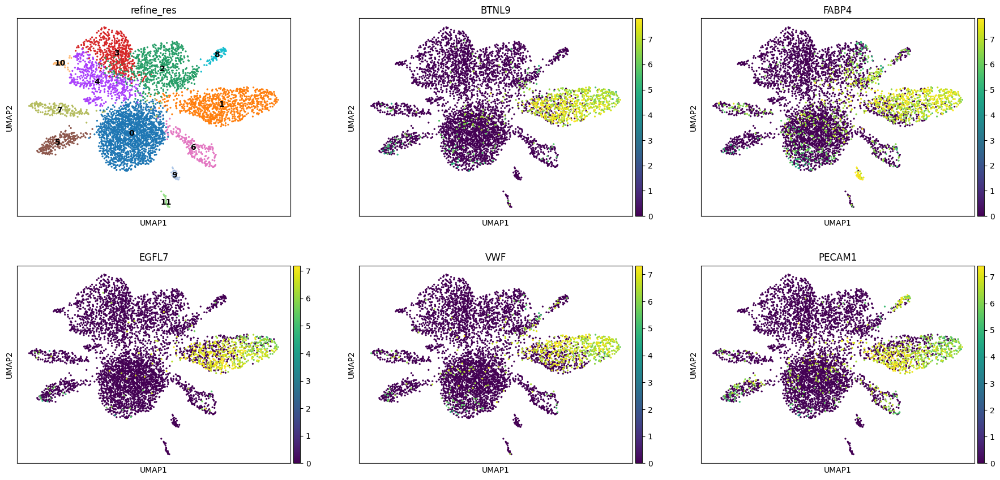

In [40]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 884
Percentage of cells in cluster 1: 16.5


In [124]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.3. Cluster 2

In [125]:
cluster_id = '2'

In [43]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Naive CD8 T cell,16
15,2,S100A+ preNeutrophil (cycling),15
16,2,preB cell,11
17,2,Naive B cell,11
18,2,CD16+ NK,8
19,2,CD14+MHCIIhigh monocyte,7
20,2,CD14+MHCIIlow monocyte,5


In [44]:
top_ranked_genes[cluster_id]

0     CALD1
1    CXCL12
2    PDGFRB
3      VCAN
4    COL1A2
Name: 2, dtype: object

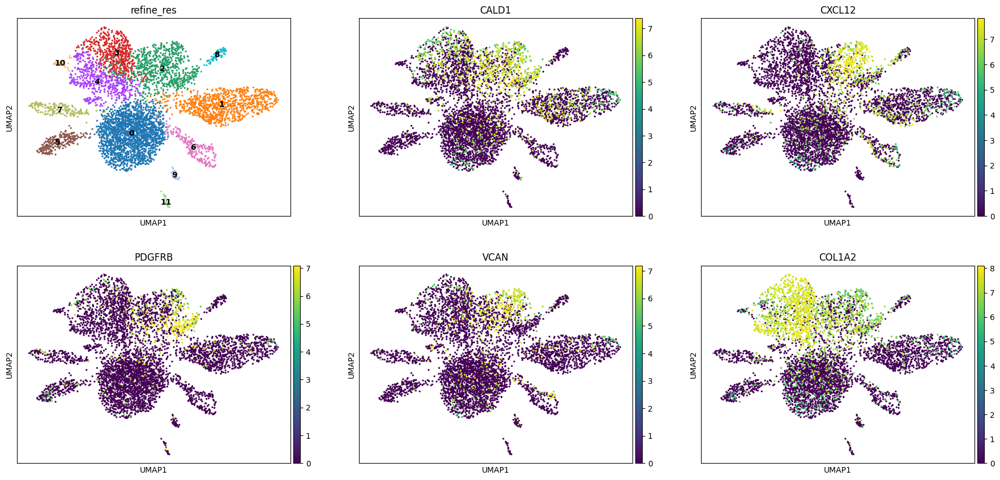

In [45]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 740
Percentage of cells in cluster 2: 13.8


In [126]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.4. Cluster 3

In [127]:
cluster_id = '3'

In [49]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Naive CD8 T cell,20
22,3,S100A+ preNeutrophil (cycling),19
23,3,Naive B cell,14
24,3,preB cell,11
25,3,GZMB+ CD8 T cell,5
26,3,Effector/Memory CD4 T cell,4
27,3,Early SOX4+ erythroblast,3


In [50]:
top_ranked_genes[cluster_id]

0    COL1A1
1    COL1A2
2    COL6A3
3     SPARC
4    COL5A2
Name: 3, dtype: object

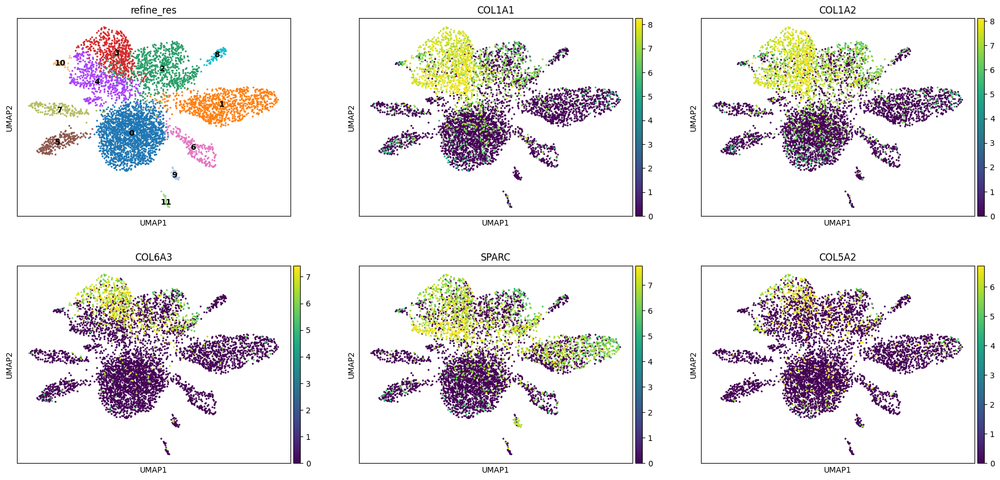

In [51]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [52]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 511
Percentage of cells in cluster 3: 9.5


In [128]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoblast'

### 5.5. Cluster 4

In [129]:
cluster_id = '4'

In [54]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Naive CD8 T cell,20
29,4,preB cell,12
30,4,S100A+ preNeutrophil (cycling),10
31,4,Naive B cell,10
32,4,GZMB+ CD8 T cell,9
33,4,CD16+ NK,5
34,4,Effector/Memory CD4 T cell,4


In [55]:
top_ranked_genes[cluster_id]

0    COL1A1
1    COL1A2
2     SPARC
3      SPP1
4     FGFR1
Name: 4, dtype: object

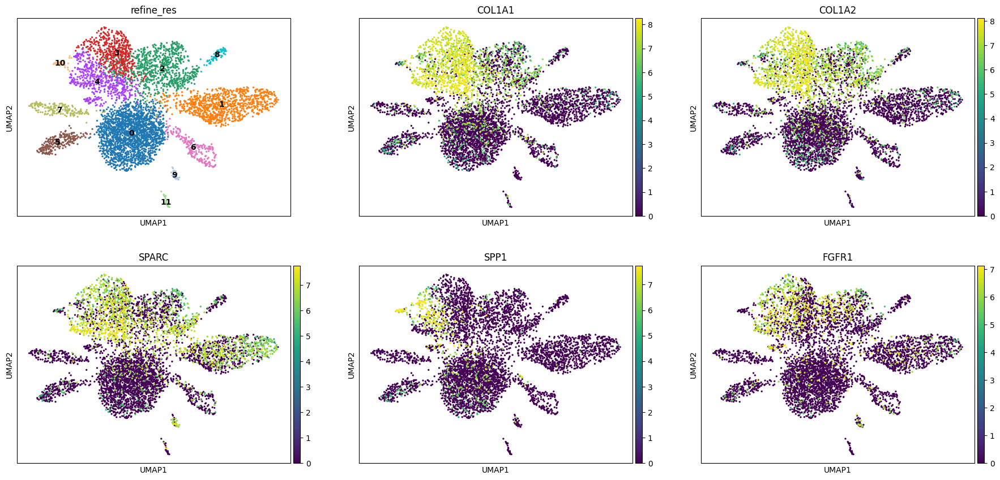

In [56]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [57]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 511
Percentage of cells in cluster 4: 9.5


In [130]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoblast'

### 5.6. Cluster 5

In [131]:
cluster_id = '5'

In [59]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Naive B cell,66
36,5,preB cell,21
37,5,Naive CD8 T cell,3
38,5,S100A+ preNeutrophil (cycling),2
39,5,Memory B cell,2
40,5,MAIT,1
41,5,CD14+MHCIIhigh monocyte,1


In [60]:
top_ranked_genes[cluster_id]

0    TCL1A
1     MDM2
2     LEF1
3     MZB1
4      ERG
Name: 5, dtype: object

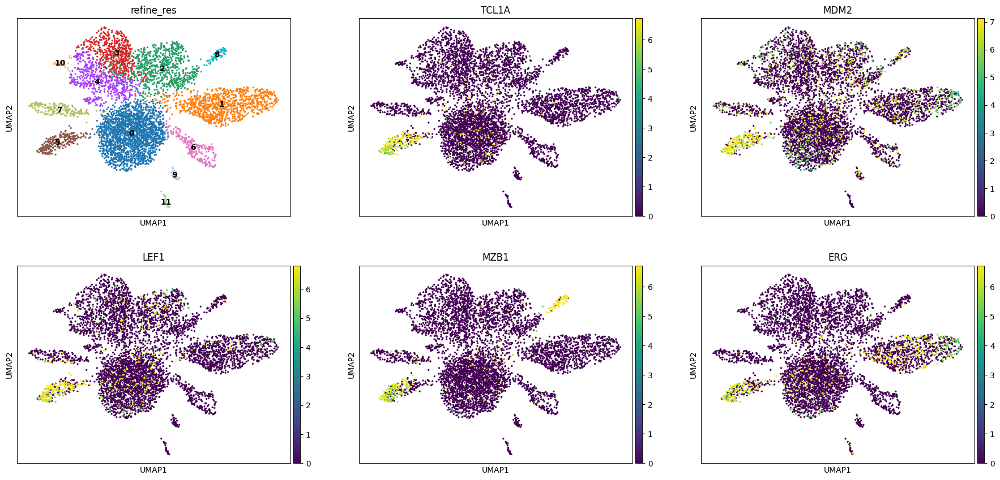

In [61]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [62]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 238
Percentage of cells in cluster 5: 4.4


In [132]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.7. Cluster 6

In [133]:
cluster_id = '6'

In [64]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,CD14+MHCIIhigh monocyte,34
43,6,S100A+ preNeutrophil (cycling),31
44,6,Naive B cell,14
45,6,CD14+MHCIIlow monocyte,7
46,6,preB cell,7
47,6,CD16+ NK,1
48,6,Memory B cell,1


In [65]:
top_ranked_genes[cluster_id]

0     MPEG1
1    MS4A6A
2    RASSF4
3     CD163
4    MS4A4A
Name: 6, dtype: object

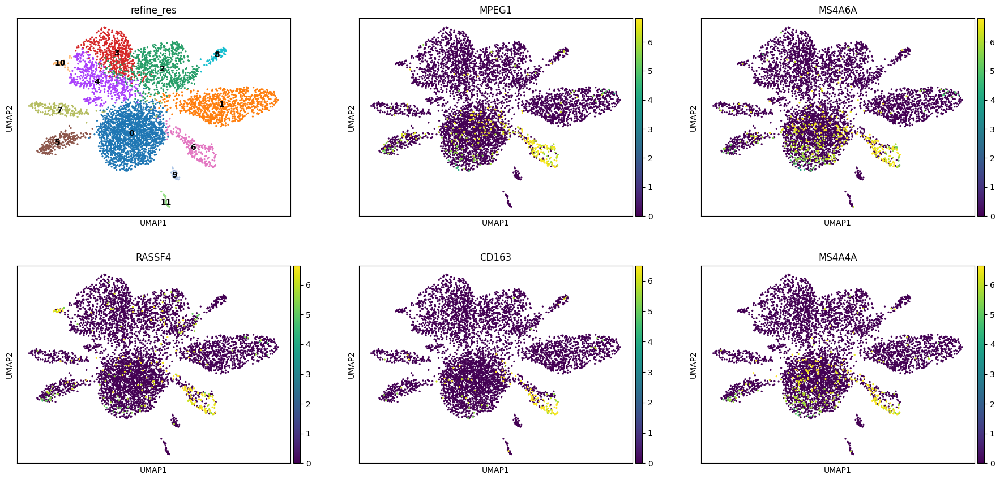

In [66]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [67]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 205
Percentage of cells in cluster 6: 3.8


In [134]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.8. Cluster 7

In [135]:
cluster_id = '7'

In [69]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,CD16+ NK,43
50,7,GZMB+ CD8 T cell,20
51,7,Effector/Memory CD4 T cell,9
52,7,Naive CD8 T cell,6
53,7,preB cell,5
54,7,Naive B cell,4
55,7,CD14+MHCIIlow monocyte,3


In [70]:
top_ranked_genes[cluster_id]

0    PTPRC
1     TRAC
2      CD2
3    CD247
4     NKG7
Name: 7, dtype: object

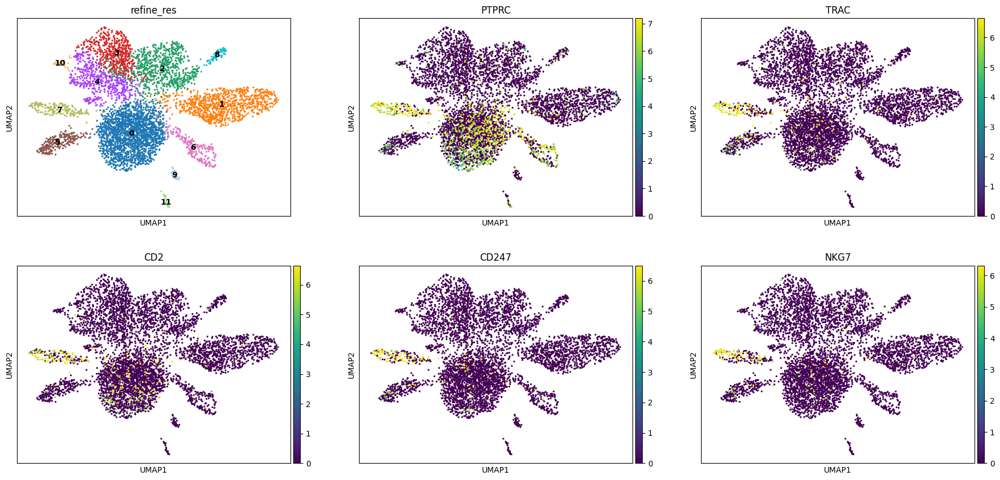

In [71]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 182
Percentage of cells in cluster 7: 3.4


In [136]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T/NK'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T/NK'

### 5.9. Cluster 8

In [137]:
cluster_id = '8'

In [74]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Naive B cell,42
57,8,preB cell,33
58,8,CD16+ NK,7
59,8,Memory B cell,4
60,8,Naive CD8 T cell,3
61,8,Treg,3
62,8,S100A+ preNeutrophil (cycling),3


In [75]:
top_ranked_genes[cluster_id]

0    TENT5C
1      MZB1
2      GAS6
3    SLAMF7
4    PECAM1
Name: 8, dtype: object

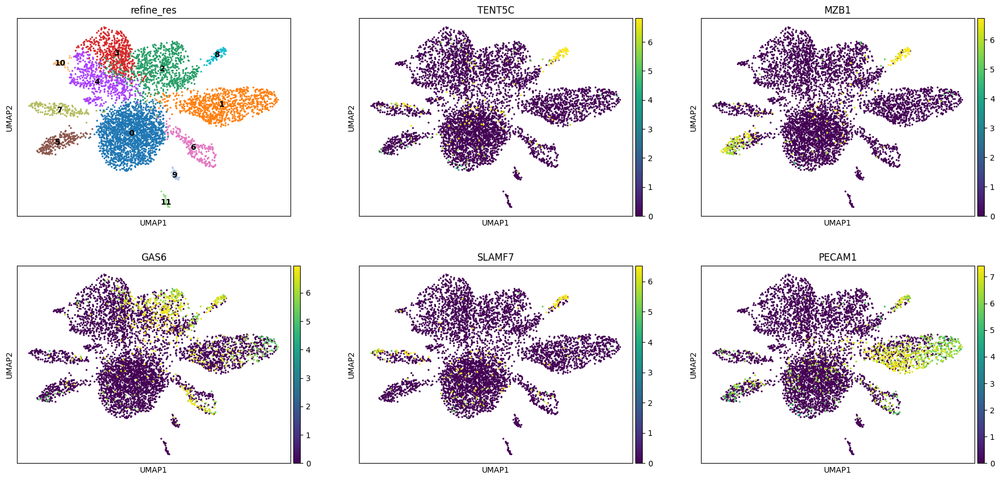

In [76]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 72
Percentage of cells in cluster 8: 1.3


In [138]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.10. Cluster 9

In [139]:
cluster_id = '9'

In [79]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,S100A+ preNeutrophil (cycling),29
64,9,Naive CD8 T cell,13
65,9,Naive B cell,13
66,9,Early SOX4+ erythroblast,11
67,9,CD16+ NK,8
68,9,Tissue-resident NK cell,5
69,9,MAIT,5


In [80]:
top_ranked_genes[cluster_id]

0    PLIN4
1    FABP4
2      LPL
3     MEST
4    PPARG
Name: 9, dtype: object

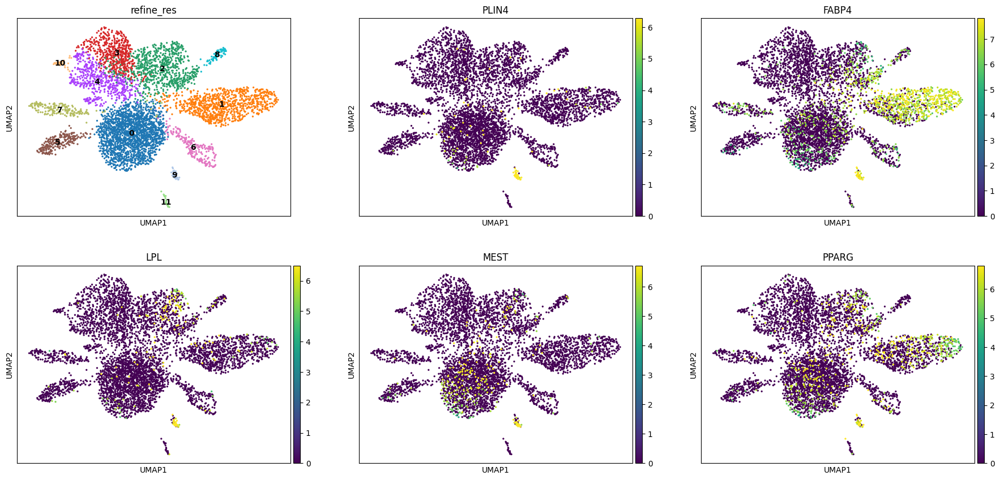

In [81]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [82]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 38
Percentage of cells in cluster 9: 0.7


In [140]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Adipocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Adipocyte'

### 5.11. Cluster 10

In [141]:
cluster_id = '10'

In [84]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,Naive B cell,30
71,10,S100A+ preNeutrophil (cycling),15
72,10,Naive CD8 T cell,9
73,10,GZMB+ CD8 T cell,9
74,10,CD14+MHCIIhigh monocyte,9
75,10,CD16+ NK,6
76,10,Naive CD4 T cell,3


In [85]:
top_ranked_genes[cluster_id]

0      CTSK
1      MMP9
2      SPP1
3    RASSF4
4    COL1A1
Name: 10, dtype: object

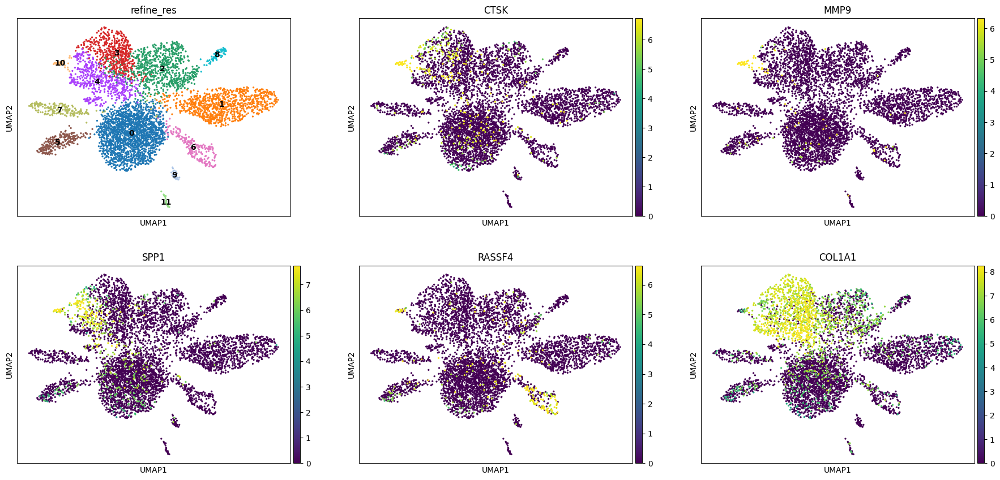

In [86]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [87]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 33
Percentage of cells in cluster 10: 0.6


In [142]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoclast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoclast'

### 5.12. Cluster 11

In [143]:
cluster_id = '11'

In [89]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
77,11,Early SOX4+ erythroblast,26
78,11,Memory B cell,15
79,11,S100A+ preNeutrophil (cycling),11
80,11,CD16+ NK,11
81,11,preB cell,11
82,11,CD16+ monocyte,4
83,11,CD14+MHCIIhigh monocyte,4


In [90]:
top_ranked_genes[cluster_id]

0    SLC18A2
1      GATA2
2      VWA5A
3      MS4A2
4        KIT
Name: 11, dtype: object

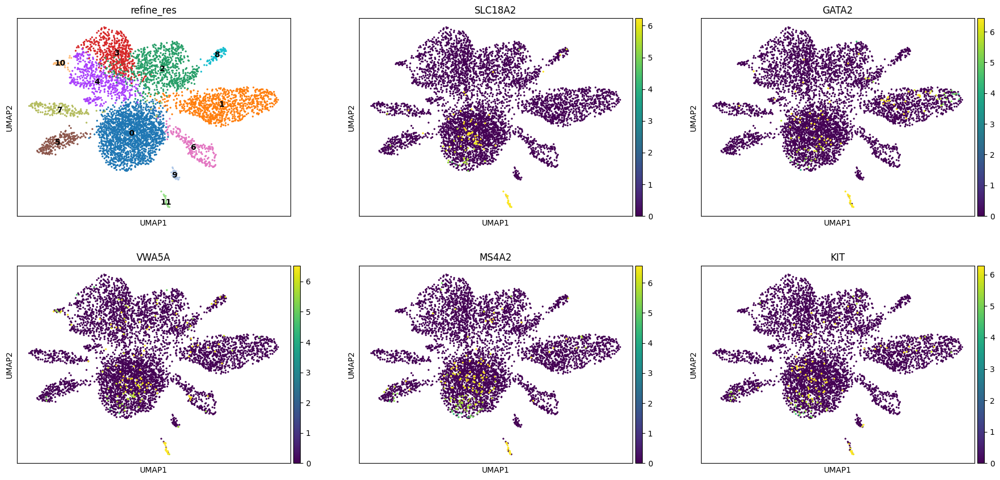

In [91]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [92]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 27
Percentage of cells in cluster 11: 0.5


In [144]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

## 6. Cancer cells

In [145]:
adata.obs['label1'].unique()

array(['Osteoblast', 'B', 'Unknown', 'Fibroblast', 'Endothelial',
       'Osteoclast', 'Monocyte/Macrophage', 'Adipocyte', 'T/NK', 'Plasma',
       'Mast'], dtype=object)

In [146]:
adata.obs['label2'].unique()

array(['Osteoblast', 'B', 'Unknown', 'Fibroblast', 'Endothelial',
       'Osteoclast', 'Monocyte/Macrophage', 'Adipocyte', 'T/NK', 'Plasma',
       'Mast'], dtype=object)

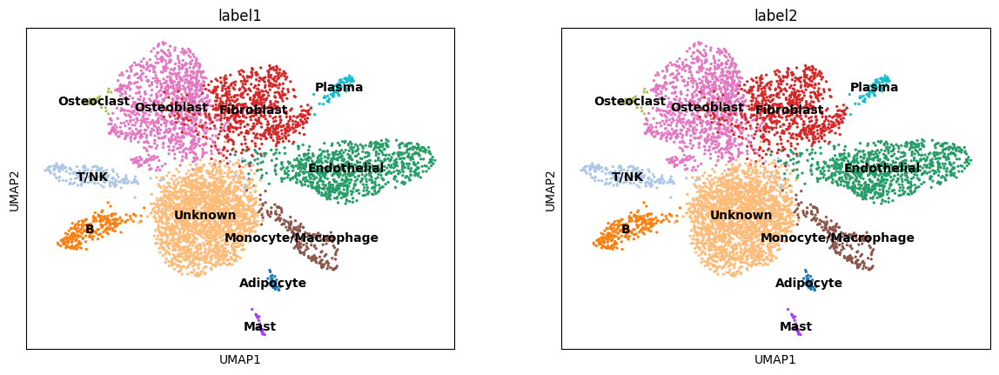

In [147]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [148]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'

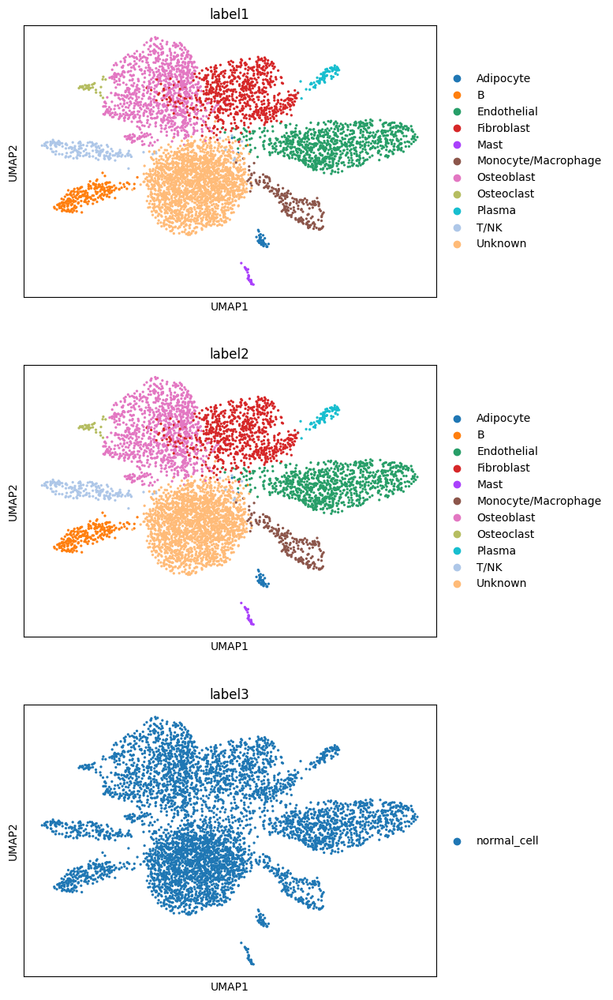

In [149]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [150]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.247191,Effector/Memory CD4 T cell,11,1,1,4,4,Osteoblast,Osteoblast,normal_cell
aaaaaaba-1,nucleus_boundaries,morpho,aaaaaaba-1,30.344586,S100A+ preNeutrophil (cycling),19,1,1,3,3,Osteoblast,Osteoblast,normal_cell
aaaaaabh-1,nucleus_boundaries,morpho,aaaaaabh-1,32.060425,Naive B cell,50,3,4,5,5,B,B,normal_cell
aaaaaabm-1,nucleus_boundaries,morpho,aaaaaabm-1,32.624612,Naive B cell,55,3,4,5,5,B,B,normal_cell
aaaaaabn-1,nucleus_boundaries,morpho,aaaaaabn-1,41.002156,preB cell,57,3,4,5,5,B,B,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaaidkd-1,nucleus_boundaries,morpho,aaaaidkd-1,42.196150,CD14+MHCIIlow monocyte,52,3,4,5,5,B,B,normal_cell
aaaaidkj-1,nucleus_boundaries,morpho,aaaaidkj-1,26.285835,CD16+ NK,11,0,0,0,0,Unknown,Unknown,normal_cell
aaaaidln-1,nucleus_boundaries,morpho,aaaaidln-1,15.261962,CD14+MHCIIlow monocyte,14,0,0,0,0,Unknown,Unknown,normal_cell
aaaaidmc-1,nucleus_boundaries,morpho,aaaaidmc-1,44.587439,preB cell,31,0,0,0,0,Unknown,Unknown,normal_cell


In [151]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")